# Prepare Fors2  to save in a fits file

- author : Sylvie Dagoret-Campagne
- affiliation : IJCLab/IN2P3/CNRS
- creation date : 2022/12/28
- last update : 2023/01/13
- FORS2 : https://github.com/ericnuss/fors2
- Result of StarLight : /sps/lsst/groups/photoz/fors2/FORS2/ResStarlight



          /Users/dagoret/MacOSX/GitHub/LSST/FORS2>ls -l
              total 0
              drwxrwsr-x  3 dagoret  staff   96 Aug 21  2018 ResStarlight
              drwxr-xr-x  9 dagoret  staff  288 Dec 19 18:01 fors2

## Import

In [1]:
import os,sys,re
from astropy.io import fits
from astropy.table import Table

In [2]:
# Import some generally useful packages

import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cm as cmx

from matplotlib.backends.backend_pdf import PdfPages

%matplotlib inline
import pandas as pd
from itertools import cycle, islice


In [3]:
from scipy.interpolate import interp1d

import glob
import collections
#from def_raw_seds import *

In [4]:
from astropy.io import fits
import copy

In [5]:
# to enlarge the sizes
params = {'legend.fontsize': 'large',
          'figure.figsize': (8, 4),
         'axes.labelsize': 'xx-large',
         'axes.titlesize':'xx-large',
         'xtick.labelsize':'xx-large',
         'ytick.labelsize':'xx-large'}
plt.rcParams.update(params)

In [6]:
import matplotlib.offsetbox
props = dict(boxstyle='round',edgecolor="w",facecolor="w", alpha=0.5)

In [7]:
from def_raw_seds import *

In [8]:
from raw_data_analysis import *

In [9]:
# Import the primary photometry classes from rubin_sim.photUtils

import rubin_sim.photUtils.Bandpass as Bandpass
import rubin_sim.photUtils.Sed as Sed
from rubin_sim.data import get_data_dir

In [10]:
pysynphot_root_path=os.environ['PYSYN_CDBS']
path_sed_calspec=os.path.join(pysynphot_root_path,'calspec')
# pysynphot
import pysynphot as S
S.refs.setref(area=1)
S.refs.getref()

{'graphtable': '/Users/dagoret/MacOSX/External/PySynPhotData/grp/hst/cdbs/mtab/14l1632sm_tmg.fits',
 'comptable': '/Users/dagoret/MacOSX/External/PySynPhotData/grp/hst/cdbs/mtab/16n1832tm_tmc.fits',
 'thermtable': '/Users/dagoret/MacOSX/External/PySynPhotData/grp/hst/cdbs/mtab/tae17277m_tmt.fits',
 'area': 1,
 'waveset': 'Min: 500, Max: 26000, Num: 10000, Delta: None, Log: True'}

## Start

In [42]:
cwd=os.path.abspath("")
main_dir = cwd
print(f"notebook current executing path : {cwd}")

notebook current executing path : /Users/dagoret/MacOSX/GitHub/LSST/PhotoZ_PhD/PCA_Fors2


## Configuration

### SL

In [11]:
filename = "datatools/pcamethod1_SL_eigenvectorandcoeff.fits"
hdu = fits.open(filename)

In [12]:
hdu.info()

Filename: datatools/pcamethod1_SL_eigenvectorandcoeff.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      12   (6362, 553)   float64   
  1                1 ImageHDU         8   (10, 550)   float64   
  2                1 ImageHDU         8   (6361, 10)   float64   


In [41]:
data1=hdu[0].data
hdr1 = hdu[0].header
hdr1

SIMPLE  =                    T / conforms to FITS standard                      
BITPIX  =                  -64 / array data type                                
NAXIS   =                    2 / number of array dimensions                     
NAXIS1  =                 6362                                                  
NAXIS2  =                  553                                                  
EXTEND  =                    T                                                  
DATAWLS = 'data[0,1:]'                                                          
DATALLAV= 'data[1,1:]'                                                          
DATALLST= 'data[2,1:]'                                                          
DATAFL  = 'data[3:,1:]'                                                         
DATANUM = 'data[3:,0]'                                                          
COMMENT Spectra of StarLight                                                    

In [14]:
data2=hdu[1].data
hdr2 = hdu[1].header
hdr2

XTENSION= 'IMAGE   '           / Image extension                                
BITPIX  =                  -64 / array data type                                
NAXIS   =                    2 / number of array dimensions                     
NAXIS1  =                   10                                                  
NAXIS2  =                  550                                                  
PCOUNT  =                    0 / number of parameters                           
GCOUNT  =                    1 / number of groups                               
COMMENT PCA method 1 spectra coefficients                                       

In [15]:
data3=hdu[2].data
hdr3 = hdu[2].header
hdr3

XTENSION= 'IMAGE   '           / Image extension                                
BITPIX  =                  -64 / array data type                                
NAXIS   =                    2 / number of array dimensions                     
NAXIS1  =                 6361                                                  
NAXIS2  =                   10                                                  
PCOUNT  =                    0 / number of parameters                           
GCOUNT  =                    1 / number of groups                               
COMMENT PCA method 1 Eigen Vectors                                              

In [16]:
NSED = data1.shape[0]-3
NWL = data1.shape[1]-1

In [17]:
wavelengths = data1[0,1:] 
flambdas_average = data1[1,1:] 
flambdas_std = data1[2,1:] 
spec = data1[3:,1:] 
all_numbers = data1[3:,0] 

In [18]:
# wavelength bin colors
jet = plt.get_cmap('jet')
cNorm = colors.Normalize(vmin=0, vmax=NSED)
scalarMap = cmx.ScalarMappable(norm=cNorm, cmap=jet)
all_colors = scalarMap.to_rgba(np.arange(NSED), alpha=1)

### Fors2

### Catalog

In [19]:
t = Table.read(filename_fits_catalog)

/Users/dagoret/anaconda3/lib/python3.9/site-packages/astropy/io/fits/connect.py:276: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask = data[col.name] == col.null


In [20]:
t

ID,m_ID,RAJ2000,DEJ2000,z,u_z,Rmag,RV,e_RV,RT,Nsp,Lines
,,deg,deg,,,mag,km / s,km / s,,,
int16,bytes1,float64,float64,float64,bytes1,float64,int32,int16,float64,int16,bytes77
1,,13.52815,-28.40486,0.55409,,20.79,166227,55,10.0,1,"[OII],H8,K,H"
2,,13.52997,-28.44776,0.34555,,21.18,103665,40,12.3,1,"K,H,G,H{beta}"
3,,13.52552,-28.4208,0.6866,,21.45,210642,48,11.6,4,"[OII],H9,K,H,H{beta},[OIII],H8"
4,,13.52216,-28.40914,0.68653,,21.62,205959,123,10.6,1,"[OII],H9,K,H,G,H{beta}"
7,,13.50974,-28.42972,0.32371,,22.34,97111,11,16.7,6,"[OII],H{beta},[OIII],H{alpha}"
9,,13.50219,-28.40641,0.29266,,21.6,87798,58,13.1,1,"H9,H8,K,H"
11,,13.49724,-28.39487,0.62688,,22.09,188063,17,24.3,3,"[OII],H10,H8,K,H,H{delta}"
12,,13.49584,-28.39125,0.2973,,21.97,89189,30,14.8,2,"[OII],H10,H9,H8,K,H"


### List

In [21]:
lst=fors2_jct_SL() #remet les spectres dans le rest frame (ie a z=0)

In [22]:
lst = sorted(lst)
print(lst)

['SPEC102', 'SPEC106', 'SPEC107', 'SPEC109', 'SPEC110', 'SPEC111', 'SPEC112', 'SPEC113', 'SPEC114', 'SPEC115', 'SPEC117', 'SPEC118', 'SPEC120', 'SPEC121', 'SPEC123', 'SPEC127', 'SPEC128', 'SPEC13', 'SPEC132', 'SPEC134', 'SPEC135', 'SPEC137', 'SPEC138', 'SPEC141', 'SPEC149', 'SPEC151', 'SPEC152', 'SPEC156', 'SPEC160', 'SPEC161', 'SPEC164', 'SPEC171', 'SPEC178', 'SPEC179', 'SPEC181', 'SPEC182', 'SPEC183', 'SPEC184', 'SPEC185', 'SPEC186', 'SPEC187', 'SPEC188', 'SPEC189', 'SPEC19', 'SPEC191', 'SPEC192', 'SPEC193', 'SPEC194', 'SPEC196', 'SPEC197', 'SPEC198', 'SPEC2', 'SPEC204', 'SPEC205', 'SPEC210', 'SPEC214', 'SPEC218', 'SPEC221', 'SPEC222', 'SPEC223', 'SPEC226', 'SPEC227', 'SPEC231', 'SPEC233', 'SPEC234', 'SPEC235', 'SPEC236', 'SPEC237', 'SPEC238', 'SPEC24', 'SPEC240', 'SPEC242', 'SPEC243', 'SPEC244', 'SPEC245', 'SPEC246', 'SPEC248', 'SPEC249', 'SPEC25', 'SPEC250', 'SPEC252', 'SPEC253', 'SPEC258', 'SPEC259', 'SPEC260', 'SPEC261', 'SPEC262', 'SPEC264', 'SPEC265', 'SPEC266', 'SPEC267', 'SPE

In [23]:
all_specfilenames = os.listdir(path_out_jct)

In [24]:
all_specfilenames = sorted(all_specfilenames)

In [25]:
all_numbers = [ int(re.findall('^SPEC(.*)[.]txt$',fn)[0]) for fn in all_specfilenames ]

In [26]:
all_numbers = sorted(all_numbers)

In [27]:
print(all_numbers)

[2, 3, 9, 13, 19, 24, 25, 30, 31, 32, 33, 34, 35, 36, 37, 45, 47, 49, 51, 55, 57, 58, 59, 61, 62, 66, 67, 68, 69, 70, 71, 72, 73, 77, 79, 80, 83, 84, 85, 86, 87, 89, 91, 93, 96, 97, 102, 106, 107, 109, 110, 111, 112, 113, 114, 115, 117, 118, 120, 121, 123, 127, 128, 132, 134, 135, 137, 138, 141, 149, 151, 152, 156, 160, 161, 164, 171, 178, 179, 181, 182, 183, 184, 185, 186, 187, 188, 189, 191, 192, 193, 194, 196, 197, 198, 204, 205, 210, 214, 218, 221, 222, 223, 226, 227, 231, 233, 234, 235, 236, 237, 238, 240, 242, 243, 244, 245, 246, 248, 249, 250, 252, 253, 258, 259, 260, 261, 262, 264, 265, 266, 267, 268, 271, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 287, 288, 291, 292, 294, 295, 296, 297, 298, 301, 302, 303, 304, 305, 306, 307, 308, 309, 313, 315, 317, 318, 319, 321, 322, 323, 324, 325, 326, 327, 328, 329, 331, 332, 333, 334, 335, 336, 337, 338, 339, 340, 341, 343, 344, 345, 346, 348, 349, 350, 351, 352, 353, 354, 355, 357, 358, 359, 360, 361, 362, 363, 364, 365, 366, 367

In [28]:
NSED = len(all_numbers)

# wavelength bin colors
jet = plt.get_cmap('jet')
cNorm = colors.Normalize(vmin=0, vmax=NSED)
scalarMap = cmx.ScalarMappable(norm=cNorm, cmap=jet)
all_colors = scalarMap.to_rgba(np.arange(NSED), alpha=1)

In [29]:
all_normspectra = []
all_wl = []
all_wlmin = []
all_wlmax = []
all_norm= []
all_tag = []


for the_num in all_numbers:
    tcut = t["ID"] == the_num
    redshift = t[tcut]["z"].value[0]
    lines = t[tcut]["Lines"].value[0]
    filename = f"SPEC{the_num}.txt"
    tag = f"SPEC{the_num} , z={redshift:.2f}, lines={lines}"
    fullfilename = os.path.join(path_out_jct,filename)
    the_sed=SED_jct(the_num)
    arr = np.loadtxt(fullfilename)
    wl=arr[:,0]
    fl=arr[:,1]
    wlmin=wl.min()
    wlmax=wl.max()
    fint = interp1d(wl, fl,bounds_error=False)
    x = wavelengths
    y= fint(x)
    
    #renormalize wrt the average SL
    wl_indexes=np.where(np.logical_and(x>=wlmin,x<=wlmax))[0]
    xcut=x[wl_indexes]
    ycut=y[wl_indexes]
    y0=flambdas_average[wl_indexes]
    norm = np.trapz(y0,xcut)/np.trapz(ycut,xcut)
    ynorm=y*norm
    
    all_wl.append(x)
    all_normspectra.append(ynorm)
    all_wlmin.append(wlmin)
    all_wlmax.append(wlmax)
    all_norm.append(norm)
    all_tag.append(tag)

all_wlmin = np.asarray(all_wlmin )
all_wlmax = np.asarray(all_wlmax)
all_norm = np.asarray(all_norm)


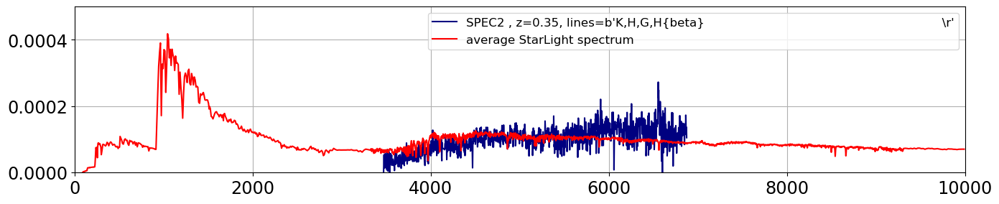

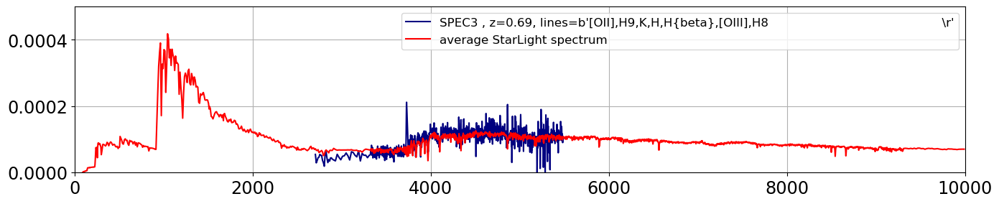

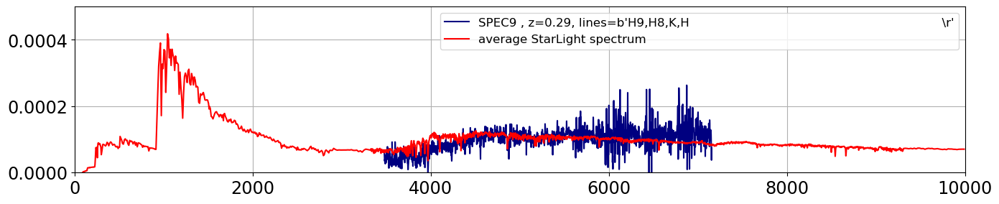

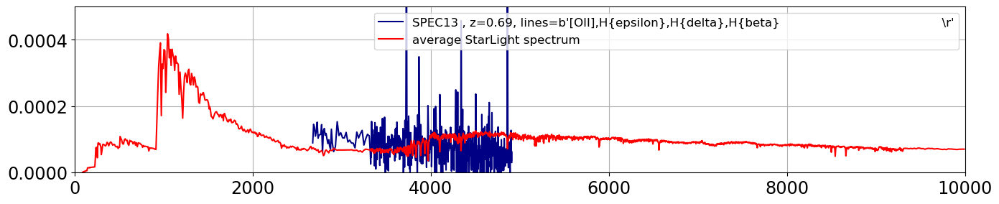

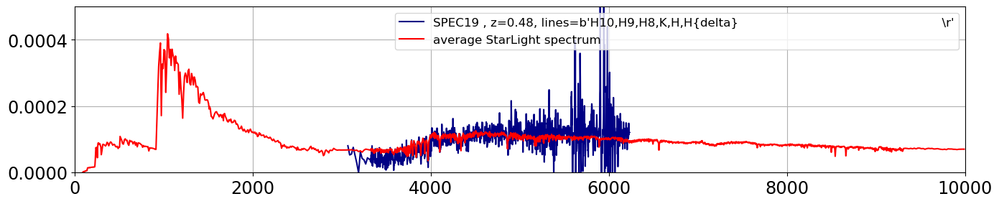

...

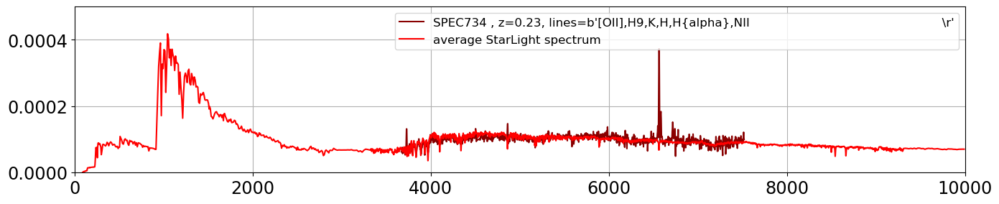

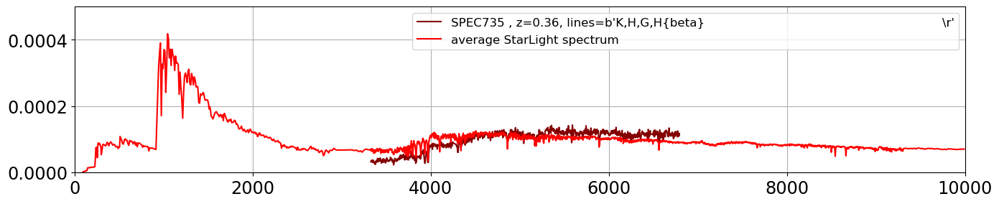

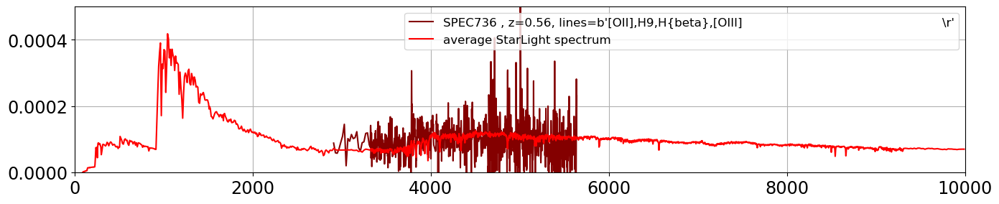

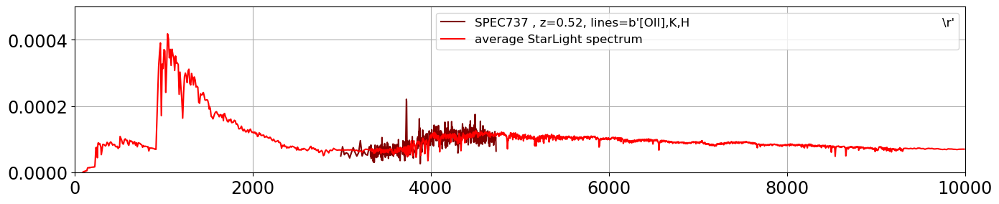

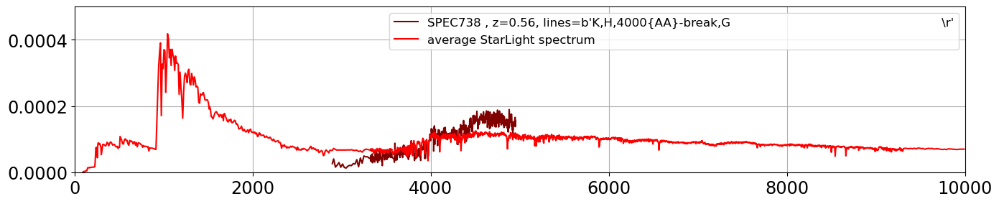

In [30]:
#plt.figure(figsize=(16,20))
for idx in range(NSED):
#for idx in range(300,NSED):
    plt.figure(figsize=(16,3))
    plt.plot(all_wl[idx],all_normspectra[idx], color=all_colors[idx],label=all_tag[idx])
    plt.plot(wavelengths,flambdas_average,'r-',label="average StarLight spectrum")
    plt.legend(loc="upper right")
    plt.grid()
    plt.ylim(0,0.0005)
    plt.xlim(0.,10000.)
    plt.show()


### Convert in numpy array

In [31]:
np.where(np.isnan(all_normspectra[0]))

(array([   0,    1,    2, ..., 6358, 6359, 6360]),)

In [32]:
np.argwhere(np.isnan(all_normspectra[0]))

array([[   0],
       [   1],
       [   2],
       ...,
       [6358],
       [6359],
       [6360]])

In [33]:
flambdas_fors2 = np.stack(all_normspectra, axis=0 )

# Save data

In [34]:
hdr = fits.Header()

In [35]:
hdr["COMMENT"]  = "Spectra of Fors2"
hdr["DATAWLS"]  = "data[0,3:]"
hdr["DATALLAV"] = "data[1,3:]"
hdr["DATALLST"] = "data[2,3:]"
hdr["DATAFL"]   = "data[3:,3:]"
hdr["DATANUM"]  = "data[3:,0]"
hdr["DAWLMIN"]  = "data[3:,1]"
hdr["DAWLMAX"]  = "data[3:,2]"

In [36]:
data_out = np.zeros((NSED+3,NWL+3))

In [37]:
data_out[0,3:] = wavelengths
data_out[1,3:] = flambdas_average
data_out[2,3:] = flambdas_std
data_out[3:,3:] = flambdas_fors2
data_out[3:,0] = all_numbers
data_out[3:,1] = all_wlmin
data_out[3:,2] = all_wlmax

In [38]:
file_out = 'Fors2_data.fits'

In [39]:
fits.writeto(file_out, data_out,hdr,overwrite=True)